<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Hey-friends-:)" data-toc-modified-id="Hey-friends-:)-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Hey friends :)</a></span></li><li><span><a href="#Compartment-Architecture" data-toc-modified-id="Compartment-Architecture-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Compartment Architecture</a></span></li><li><span><a href="#Data-Pre-processing" data-toc-modified-id="Data-Pre-processing-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Data Pre-processing</a></span><ul class="toc-item"><li><span><a href="#outflows_data" data-toc-modified-id="outflows_data-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>outflows_data</a></span></li><li><span><a href="#transitions_data" data-toc-modified-id="transitions_data-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>transitions_data</a></span></li><li><span><a href="#total_population_data" data-toc-modified-id="total_population_data-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>total_population_data</a></span></li><li><span><a href="#Uploading-our-data" data-toc-modified-id="Uploading-our-data-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Uploading our data</a></span></li></ul></li><li><span><a href="#Running-a-baseline" data-toc-modified-id="Running-a-baseline-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Running a baseline</a></span></li><li><span><a href="#Running-a-policy-scenario" data-toc-modified-id="Running-a-policy-scenario-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Running a policy scenario</a></span></li><li><span><a href="#Extensions" data-toc-modified-id="Extensions-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Extensions</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#We-collapsed-jail-and-prison-into-a-single-compartment,-but-they-likely-behave-very-differently-in-real-life.-Go-back-to-the-beginning-and-re-do-the-processing-after-adding-a-jail-compartment-to-the-model-architecture." data-toc-modified-id="We-collapsed-jail-and-prison-into-a-single-compartment,-but-they-likely-behave-very-differently-in-real-life.-Go-back-to-the-beginning-and-re-do-the-processing-after-adding-a-jail-compartment-to-the-model-architecture.-6.0.1"><span class="toc-item-num">6.0.1&nbsp;&nbsp;</span>We collapsed jail and prison into a single compartment, but they likely behave very differently in real life. Go back to the beginning and re-do the processing after adding a jail compartment to the model architecture.</a></span></li><li><span><a href="#Can-you-implement-a-different-policy-(or-the-same-one)-using-a-different-policy-function-from-CompartmentTransitions.apply_reduction()?" data-toc-modified-id="Can-you-implement-a-different-policy-(or-the-same-one)-using-a-different-policy-function-from-CompartmentTransitions.apply_reduction()?-6.0.2"><span class="toc-item-num">6.0.2&nbsp;&nbsp;</span>Can you implement a different policy (or the same one) using a different policy function from CompartmentTransitions.apply_reduction()?</a></span></li><li><span><a href="#Can-you-add-recidivism-into-the-model?" data-toc-modified-id="Can-you-add-recidivism-into-the-model?-6.0.3"><span class="toc-item-num">6.0.3&nbsp;&nbsp;</span>Can you add recidivism into the model?</a></span></li></ul></li></ul></li></ul></div>

# Hey friends :)
This notebook will walk you through running your first policy simulation! You should run each cell of code–starting with the imports under this text–working down the notebook sequentially. There will be text boxes like this one instructing you what you need to fill in to get stuff working. 

You're encouraged to experiment, visualize, and add cells as you please. You don't need to understand every line of code you're running, but obviously you can look up functions and stuff that did nifty things you want to be able to reproduce.

In [264]:
import os
import sys
sys.path.insert(0, os.path.relpath('../../../../..')) 

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from recidiviz.calculator.modeling.population_projection.super_simulation.super_simulation_factory import SuperSimulationFactory
from recidiviz.calculator.modeling.population_projection.transition_table import TransitionTable
from recidiviz.calculator.modeling.population_projection.spark_policy import SparkPolicy
from recidiviz.calculator.modeling.population_projection.utils.spark_bq_utils import upload_spark_model_inputs
import pandas as pd
from functools import partial

pd.set_option('display.max_rows', 500)

# Compartment Architecture
The first step in Spark modeling is always to decide what compartment architecture you want to build around. In our case, we're gonna use this one:

**'pretrial' (shell compartment) --> 'prison' (full compartment) --> 'release' (full compartment)**

Make sure you use these three compartment names in your data processing!

# Data Pre-processing
We're skipping the early part for now, but you'll still need to get from "clean" data to the data inputs that the Spark model ingests. Feel free to run this cell without thinking about it too much.

In [265]:
raw_va_sentence_df = pd.read_csv(
    '../state/VA/VA_data/unprocessed_va_historical_sentences_v2.csv',
    sep='\t'
)

raw_va_sentence_df

,Offense Group,VCC,Off1VCC,JudgeID,ActDisp,FiscalYr,Off1Date,EffLif,effsent,OffLName,OffFName
0,ASSAULT,ASL1316,ASL1316F6,0,3.0,2018.0,5/20/2017,0.0,18.0,MOORE,KENNETH
1,NaN,NaN,NaN,NaN,NaN,2019.0,4/25/2018,0.0,10.0,CLINE,MATTHEW
2,NaN,NaN,NaN,10DB,1.0,2018.0,11/11/2017,0.0,0.0,TINSLEY,JAVON
3,NaN,NaN,NaN,NaN,2.0,2017.0,6/8/2015,0.0,0.0,COMPTON,ROBERT
4,NaN,NaN,NaN,NaN,3.0,2017.0,12/25/2016,0.0,7.0,MILLER,MARCUS
...,...,...,...,...,...,...,...,...,...,...,...
74313,NaN,NaN,NaN,9MM,3.0,2018.0,6/1/2017,0.0,8.0,CUNNINGHAM,JACOB
74314,NaN,NaN,NaN,NaN,NaN,NaN,6/27/2017,0.0,13.0,STURDIVANT,JUSTIN
74315,NaN,NaN,NaN,NaN,NaN,2019.0,11/30/2017,0.0,7.0,MAINES,BRADY
74316,NaN,NaN,NaN,9TH,2.0,2018.0,12/26/2016,0.0,5.0,MORRIS,DAVID


In [266]:
# read the data from the csv file into a dataframe
raw_va_sentence_df = pd.read_csv(
    '../state/VA/VA_data/unprocessed_va_historical_sentences_v2.csv',
    sep='\t'
)

# add new columns to the dataframe with data from the csv file, filling in empty slots
# ask Paco: how do you know you can fill in empty values with ones from the previous row?
raw_va_sentence_df['crime_type'] = raw_va_sentence_df['Offense Group'].ffill()
raw_va_sentence_df['offense_code'] = raw_va_sentence_df['VCC'].ffill()
raw_va_sentence_df['crime'] = raw_va_sentence_df['Off1VCC'].ffill()
raw_va_sentence_df['judge_id'] = raw_va_sentence_df['JudgeID'].ffill()
raw_va_sentence_df['sentence_type_code'] = raw_va_sentence_df['ActDisp'].ffill()
raw_va_sentence_df['effective_sentence_months'] = raw_va_sentence_df['effsent']
raw_va_sentence_df['fiscal_year'] = raw_va_sentence_df['FiscalYr'].ffill()

# ask Paco: you don't fill in empty values for these columns--why? will that interfere with the analysis later?
raw_va_sentence_df['life_sentence'] = raw_va_sentence_df['EffLif']
raw_va_sentence_df = raw_va_sentence_df.rename({'Off1Date':'offense_date'}, axis=1)

# redefine the dataframe that we're using based on what we're interested in
# ask Paco: is this processing done based on the policy you're looking at, or just general?
# what's sentence_type_code == 1? why would someone have 0 effective sentence months?
raw_va_sentence_df = raw_va_sentence_df[raw_va_sentence_df.sentence_type_code != 1]
raw_va_sentence_df = raw_va_sentence_df[raw_va_sentence_df.effective_sentence_months != 0]

# filter rows where crime_type is not total (what is total crime type?)
raw_va_sentence_df = raw_va_sentence_df[~raw_va_sentence_df['crime_type'].str.contains('Total')]

# remove the columns that we don't care about
raw_va_sentence_df = raw_va_sentence_df.drop(
    ['VCC', 'Offense Group', 'Off1VCC', 'JudgeID', 'ActDisp', 'effsent', 'FiscalYr', 'EffLif'],
    axis=1
)
raw_va_sentence_df.head()

,offense_date,OffLName,OffFName,crime_type,offense_code,crime,judge_id,sentence_type_code,effective_sentence_months,fiscal_year,life_sentence
0,5/20/2017,MOORE,KENNETH,ASSAULT,ASL1316,ASL1316F6,0,3.0,18.0,2018.0,0.0
1,4/25/2018,CLINE,MATTHEW,ASSAULT,ASL1316,ASL1316F6,0,3.0,10.0,2019.0,0.0
4,12/25/2016,MILLER,MARCUS,ASSAULT,ASL1316,ASL1316F6,10DB,3.0,7.0,2017.0,0.0
5,11/17/2018,SPRADLEY,CALEB,ASSAULT,ASL1316,ASL1316F6,10DB,3.0,7.0,2019.0,0.0
7,12/11/2016,JAMES,ERIC,ASSAULT,ASL1316,ASL1316F6,10KW,3.0,14.0,2017.0,0.0


We can see the first few rows of the dataset above, but let's take a slightly more comprehensive peak at what's in here before we move on! You can run the following cells without changing anything, but feel free to play with them anyway.

In [267]:
# get descriptive statistics on dataframe with different percentiles (just to take a look at the data)
# what is life_sentence? 0 or 1 for no or yes?
raw_va_sentence_df.describe([0.05,0.25,0.5,0.75,0.95])

,sentence_type_code,effective_sentence_months,fiscal_year,life_sentence
count,52528.000000,52291.000000,52528.000000,51514.000000
mean,2.647102,26.507235,2017.991186,0.001398
std,0.477876,70.993842,0.817416,0.037360
min,2.000000,0.032854,2017.000000,0.000000
5%,2.000000,0.985626,2017.000000,0.000000
25%,2.000000,4.000000,2017.000000,0.000000
50%,3.000000,12.000000,2018.000000,0.000000
75%,3.000000,24.000000,2019.000000,0.000000
95%,3.000000,96.000000,2019.000000,0.000000
max,3.000000,5052.000000,2019.000000,1.000000


,offense_date,OffLName,OffFName,crime_type,offense_code,crime,judge_id,sentence_type_code,effective_sentence_months,fiscal_year,life_sentence,full_name
6764,5/7/2013,SMITH,MICHAEL,BURGLARY/OTHER,BUR2206,BUR2206F5,17WN,3.0,12.000000,2017.0,0.0,MICHAEL SMITH
7646,10/9/2016,SMITH,MICHAEL,BURGLARY/OTHER,BUR2216,BUR2216f9,4MJH,3.0,24.000000,2017.0,0.0,MICHAEL SMITH
8718,11/13/2012,SMITH,MICHAEL,DRUG OTHER,NAR3032,NAR3032F5,16TS,2.0,3.000000,2017.0,0.0,MICHAEL SMITH
9037,3/15/2018,SMITH,MICHAEL,DRUG OTHER,NAR3032,NAR3032F5,22JM,2.0,3.000000,2019.0,0.0,MICHAEL SMITH
10293,12/3/2015,SMITH,MICHAEL,DRUG OTHER,NAR3135,NAR3135F5,24JC,3.0,14.000000,2017.0,0.0,MICHAEL SMITH
12087,2/10/2016,SMITH,MICHAEL,DRUG/SCHEDULE I/II,NAR3022,NAR3022F5,12LB,2.0,3.000000,2017.0,0.0,MICHAEL SMITH
13614,5/25/2016,SMITH,MICHAEL,DRUG/SCHEDULE I/II,NAR3022,NAR3022F5,14JM,2.0,6.000000,2018.0,0.0,MICHAEL SMITH
16848,4/24/2016,SMITH,MICHAEL,DRUG/SCHEDULE I/II,NAR3022,NAR3022F5,17WN,2.0,6.000000,2017.0,0.0,MICHAEL SMITH
18111,8/13/2016,SMITH,MICHAEL,DRUG/SCHEDULE I/II,NAR3022,NAR3022F5,1RS,2.0,0.328542,2017.0,0.0,MICHAEL SMITH
31526,3/25/2014,SMITH,MICHAEL,DRUG/SCHEDULE I/II,NAR3042,NAR3042F9,13PH,3.0,108.000000,2017.0,0.0,MICHAEL SMITH


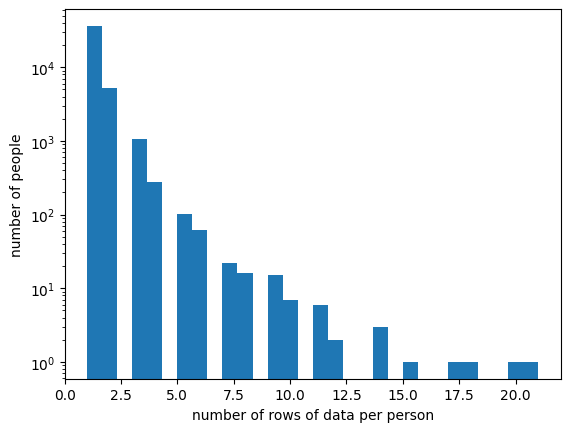

In [268]:
# combine first and last name into one full name and check the number of rows of data per person

# first, add a new column with the full name
raw_va_sentence_df['full_name'] = raw_va_sentence_df.OffFName + ' ' + raw_va_sentence_df.OffLName

# second, calculate the sentences per person: group the rows by full_name (rows with same full name grouped together)
# get a dataframe with the count of each datapoint per group, and sort from high to low
sentences_per_person = raw_va_sentence_df.groupby('full_name').count().sort_values('OffLName', ascending=False)
plt.hist(sentences_per_person.OffLName, bins = 30)
plt.ylabel('number of people')
plt.xlabel('number of rows of data per person')
plt.yscale('log')

raw_va_sentence_df[raw_va_sentence_df['full_name'] == 'MICHAEL SMITH']

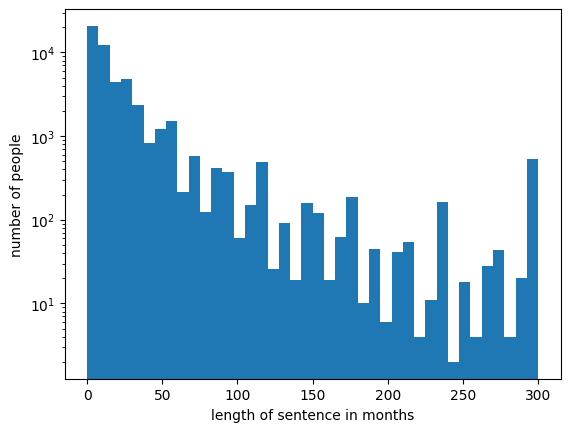

In [269]:
# Cap sentence lengths at 25 years, then plot the sentence length distribution in months.

# make a copy of the dataframe
temp = raw_va_sentence_df.copy()

# in the temporary table, any column with a value for effective_sentence_months that's greater than 25 years becomes 25 years
# ask Paco: why are we capping the sentence length?
temp.loc[temp.effective_sentence_months > 12 * 25, 'effective_sentence_months'] = 12 * 25

# when you plot a column from a dataframe, it automatically does it by count of each unique value in the column
plt.hist(temp.effective_sentence_months, bins=40)
plt.ylabel('number of people')
plt.xlabel('length of sentence in months')
plt.yscale('log')

## outflows_data
Ok, time to process our data! First up is the outflows_data table. As a reminder, outflows_data counts the number of people transitioning historically into and throughout the system. It should have one row of data per sub-group per time-step per compartment (although in our case we'll only bother with outflows for the pretrial compartment). Here is what a final outflows_data table should look like:

In [297]:
pd.DataFrame({
    'compartment': ['pretrial'] * 4,
    'outflow_to': ['probation'] * 4,
    'crime_type': ['VIOLENT'] * 2 + ['NONVIOLENT'] * 2,
    'time_step': [0,1, 0, 1],
    'total_population': [250, 233, 850, 912]
})

,compartment,outflow_to,crime_type,time_step,total_population
0,pretrial,probation,VIOLENT,0,250
1,pretrial,probation,VIOLENT,1,233
2,pretrial,probation,NONVIOLENT,0,850
3,pretrial,probation,NONVIOLENT,1,912


Okie you're up! Turn `raw_va_sentence_df` into an outflows_data table! Some important tips for this:
* Make sure you make a copy of `raw_va_sentence_df` and mess with that. If you start changing the original you won't have anything to build the other data inputs with.
* Make sure your table has exactly the right columns with the right names when you're done. df.rename() is your friend!
* `time_step` is the number of steps away from the reference date you're at. So with a reference date of 2020.0, 2021.0 would be time_step = 12. In our case, the reference_date is 2019.


In [298]:
raw_va_sentence_df
outflows_attempt = raw_va_sentence_df.copy()

In [299]:
outflows_attempt_jr = outflows_attempt.groupby(['crime_type', 'fiscal_year']).count().max(axis=1)
outflows_attempt_jr.name = 'count'
outflows_attempt_jr.reset_index()

,crime_type,fiscal_year,count
0,ASSAULT,2017.0,1464
1,ASSAULT,2018.0,1424
2,ASSAULT,2019.0,1428
3,BURGLARY/DWELLING,2017.0,565
4,BURGLARY/DWELLING,2018.0,528
5,BURGLARY/DWELLING,2019.0,440
6,BURGLARY/OTHER,2017.0,247
7,BURGLARY/OTHER,2018.0,287
8,BURGLARY/OTHER,2019.0,245
9,DRUG OTHER,2017.0,690


In [300]:
# practice with using .apply and a lambda function to edit every value in a column
def our_round(x):
    return round(x, -2)

outflows_attempt['rounded_pop'] = outflows_attempt_jr[0].apply(lambda x: our_round(x))
outflows_attempt

AttributeError: 'numpy.int64' object has no attribute 'apply'

In [347]:
outflows_attempt = raw_va_sentence_df.copy()

# Step 1: Use a groupby operation to get one row per crime_type per year.

outflows_attempt_jr = outflows_attempt.groupby(['crime_type', 'fiscal_year']).count().max(axis=1).reset_index()

# Step 2: Change the data to be per month instead of per year. Your table should get 12 times longer when you do this.

outflows = pd.DataFrame()

for _, row in outflows_attempt_jr.iterrows():
    for i in range(12):
        outflows = outflows.append({
            'crime_type': row['crime_type'],
            'time_step': (row['fiscal_year'] - 2019) * 12 + i,
            'total_population': row[0] / 12
        }, ignore_index=True)

# another way to do it:
# for _, row in outflows_attempt_jr.iterrows():
#     outflows = pd.concat([outflows, pd.DataFrame({
#         'crime_type': [row['crime_type']] * 12,
#         'time_step': [(row['fiscal_year'] - 2019) * 12 + i for i in range(12)],
#         'total_population': [row[0] / 12] * 12
#     })])
        
# Step 3: Add in any of the columns you're missing, drop any you don't want, and rename the ones you want to keep.
# Your column names should now match the example exactly.

# search through codebase maybe, or look online
# use .apply or .map: make a dictionary for violent/nonviolent crime types

# to figure out all the unique crime types in the crime_type column
outflows.crime_type.unique()

# made up categorizations! not grounded in reality
crime_category = {'ASSAULT': 'violent', 'BURGLARY/DWELLING': 'nonviolent', 'BURGLARY/OTHER': 'nonviolent', 
                  'DRUG OTHER': 'nonviolent', 'DRUG/SCHEDULE I/II': 'nonviolent', 'FRAUD': 'nonviolent',
                  'KIDNAPPING': 'violent', 'LARCENY': 'nonviolent', 'MISC/PERSON & PROPERTY': 'nonviolent', 
                  'MISC_OTHER': 'nonviolent', 'MURDER': 'violent', 'OBSCENITY': 'nonviolent',
                  'OTHER SEXUAL ASSAULT': 'violent', 'RAPE': 'violent', 'ROBBERY': 'violent', 
                  'TRAFFIC FELONY': 'nonviolent', 'WEAPONS/FIREARMS': 'nonviolent'}
outflows['violent'] = outflows['crime_type'].apply(lambda x: crime_category[x])
outflows['violent'] = outflows['violent'].str.upper()
outflows = outflows.drop('crime_type', axis=1)
outflows = outflows.rename({'violent':'crime_type'}, axis=1)

# add these columns to dataframe
outflows['compartment'] = 'pretrial'
outflows['outflow_to'] = 'prison'

outflows

# Step 4: Ensure the columns of our table have the correct types. In particular, make sure the `time_step` column
# has type int and `total_population` column has type float.

# check data types of each column in outflows
outflows['time_step'] = outflows['time_step'].astype(int)
# outflows.isnull().values.sum()


/var/folders/2b/1mk8fdhx1_n4721rb_xg8x4h0000gn/T/ipykernel_19447/1186856708.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  outflows = outflows.append({
/var/folders/2b/1mk8fdhx1_n4721rb_xg8x4h0000gn/T/ipykernel_19447/1186856708.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  outflows = outflows.append({
/var/folders/2b/1mk8fdhx1_n4721rb_xg8x4h0000gn/T/ipykernel_19447/1186856708.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  outflows = outflows.append({
/var/folders/2b/1mk8fdhx1_n4721rb_xg8x4h0000gn/T/ipykernel_19447/1186856708.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  outflows = outflows.append({
/var/folders

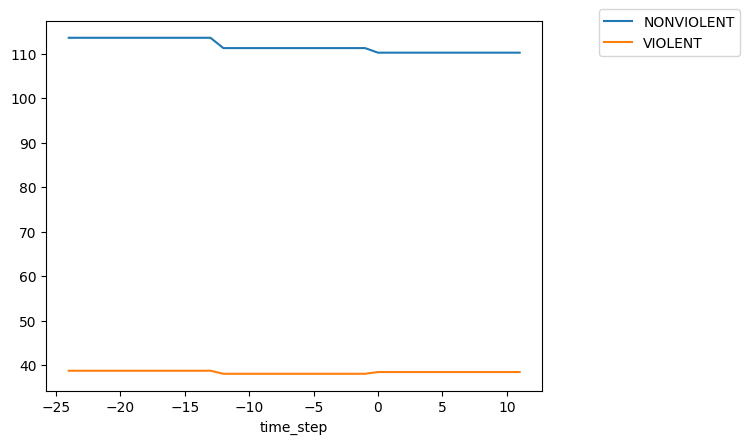

In [348]:
outflows.groupby(['time_step', 'crime_type']).total_population.mean().unstack('crime_type').plot()
plt.legend(bbox_to_anchor=(1.1, 1.05))

In [349]:
outflows

,time_step,total_population,crime_type,compartment,outflow_to
0,-24,122.00,VIOLENT,pretrial,prison
1,-23,122.00,VIOLENT,pretrial,prison
2,-22,122.00,VIOLENT,pretrial,prison
3,-21,122.00,VIOLENT,pretrial,prison
4,-20,122.00,VIOLENT,pretrial,prison
...,...,...,...,...,...
607,7,58.75,NONVIOLENT,pretrial,prison
608,8,58.75,NONVIOLENT,pretrial,prison
609,9,58.75,NONVIOLENT,pretrial,prison
610,10,58.75,NONVIOLENT,pretrial,prison


Huh, that's kinda hard to parse. Let's try pulling out just one crime type to look at:

<AxesSubplot: xlabel='time_step'>

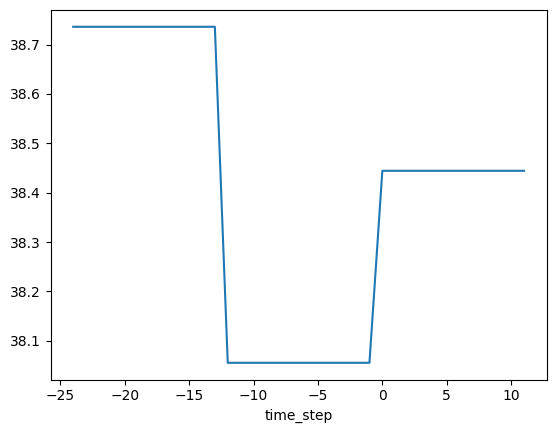

In [350]:
# Feel free to try subbing in a few different crimes to look at them one at a time
CRIME_TYPE = 'VIOLENT'
outflows.groupby(['time_step', 'crime_type']).total_population.mean().unstack('crime_type')[CRIME_TYPE].plot()

## transitions_data
On to the transitions_data table. As a reminder, transitions_data should have one row of data per sub-group per compartment duration (aka length of stay) per full compartment (aka every one except pretrial). Here is what a final transitions table should look like:

In [305]:
pd.DataFrame({
    'compartment': ['prison'] * 3 + ['release'] * 2,
    'outflow_to': ['release'] * 5,
    'crime_type': ['VIOLENT', 'VIOLENT', 'NONVIOLENT', 'VIOLENT', 'NONVIOLENT'],
    'compartment_duration': [48, 156, 30, 1, 1],
    'total_population': [0.6, 0.4, 1, 1, 1]
})

,compartment,outflow_to,crime_type,compartment_duration,total_population
0,prison,release,VIOLENT,48,0.6
1,prison,release,VIOLENT,156,0.4
2,prison,release,NONVIOLENT,30,1.0
3,release,release,VIOLENT,1,1.0
4,release,release,NONVIOLENT,1,1.0


Okie you're up! Turn `raw_va_sentence_df` into a transitions_data table! Some important tips for this:
* Make sure you make a copy of `raw_va_sentence_df` and mess with that. If you start changing the original you won't have anything to build the other data inputs with.
* Make sure your table has exactly the right columns with the right names when you're done. df.rename() is your friend!
* The total_population column of this table only cares about the ratio of values between compartment_duration values within a given subgroup and compartment. In other words, compartment_duration : total_population = (12 : 0.2, 24: 0.4, 36: 0.4) will give the same behavior as compartment_duration : total_population = (12: 20, 24: 40, 36: 40).
* Our time steps are one month, make sure the units of your `compartment_duration` column are correct.


In [306]:
transitions_attempt = raw_va_sentence_df.copy()

# drop rows with NaN values
transitions_attempt['effective_sentence_months'].isnull().sum()
transitions_attempt = transitions_attempt.loc[transitions_attempt.effective_sentence_months.notnull()]

# iloc: expects an index number
# loc: slice into dataframe, can use column names

# using brackets to index into a df uses a copy of the df, not the original
# round up instead of int, to make sure there are no 0 length sentences
# transitions_attempt['effective_sentence_months'] = transitions_attempt.effective_sentence_months.apply(int)
# transitions_attempt.effective_sentence_months = transitions_attempt.effective_sentence_months.apply(int)
transitions_attempt.loc[:, 'effective_sentence_months'] = transitions_attempt.effective_sentence_months.apply(np.ceil)

# Step 1: Use a groupby operation to get one row per crime_type per sentence length.

transitions_attempt = transitions_attempt.rename({'effective_sentence_months': 'compartment_duration'}, axis=1)
transitions_attempt = transitions_attempt.groupby(['crime_type', 'compartment_duration']).count().max(axis=1).reset_index()

# Step 2: Add in any of the columns you're missing, drop any you don't want, and rename the ones you want to keep.
# Your column names should now match the example exactly.

transitions_attempt = transitions_attempt.rename({0: 'total_population'}, axis=1)
# crime_category = {'ASSAULT': 'violent', 'BURGLARY/DWELLING': 'nonviolent', 'BURGLARY/OTHER': 'nonviolent', 
#                   'DRUG OTHER': 'nonviolent', 'DRUG/SCHEDULE I/II': 'nonviolent', 'FRAUD': 'nonviolent',
#                   'KIDNAPPING': 'violent', 'LARCENY': 'nonviolent', 'MISC/PERSON & PROPERTY': 'nonviolent', 
#                   'MISC_OTHER': 'nonviolent', 'MURDER': 'violent', 'OBSCENITY': 'nonviolent',
#                   'OTHER SEXUAL ASSAULT': 'violent', 'RAPE': 'violent', 'ROBBERY': 'violent', 
#                   'TRAFFIC FELONY': 'nonviolent', 'WEAPONS/FIREARMS': 'nonviolent'}
transitions_attempt['crime_type'] = transitions_attempt['crime_type'].apply(lambda x: crime_category[x].upper())
transitions_attempt['compartment'] = 'prison'
transitions_attempt['outflow_to'] = 'release'

# get frequency of violent and nonviolent crimes in df
[nonviolent_freq, violent_freq] = transitions_attempt['crime_type'].value_counts()

transitions_attempt.loc[transitions_attempt['crime_type'] == 'VIOLENT', 'total_population'] = transitions_attempt.total_population / violent_freq
transitions_attempt.loc[transitions_attempt['crime_type'] == 'NONVIOLENT', 'total_population'] = transitions_attempt.total_population / nonviolent_freq

transitions_attempt

# Step 3: You've now finished the transitions data for the prison compartment, but we still need transitions data
# for the release compartment. For our purposes, we're gonna assume no recidivism, which means people can just go
# from release back to release (just like the example above). Create a second transitions_data table for release
# that has one trivial transition from release to itself for each subgroup.

transitions_release = pd.DataFrame({
    'compartment': ['release'] * 2,
    'outflow_to': ['release'] * 2,
    'crime_type': ['VIOLENT', 'NONVIOLENT'],
    'compartment_duration': [1] * 2,
    'total_population': [1] * 2
})

# Step 4: Concatenate your two transitions tables together to get one final transitions_data

frames = [transitions_attempt, transitions_release]

transitions_data = pd.concat(frames)

# Step 5: Ensure the columns of our table have the correct types. In particular, make sure the `compartment_duration`
# and `total_population` columns both have type float.

transitions_data.dtypes

transitions_data

,crime_type,compartment_duration,total_population,compartment,outflow_to
0,VIOLENT,1.0,0.125485,prison,release
1,VIOLENT,2.0,0.097025,prison,release
2,VIOLENT,3.0,0.143596,prison,release
3,VIOLENT,4.0,0.087969,prison,release
4,VIOLENT,5.0,0.055627,prison,release
...,...,...,...,...,...
1652,NONVIOLENT,96.0,0.001134,prison,release
1653,NONVIOLENT,120.0,0.002268,prison,release
1654,NONVIOLENT,180.0,0.001134,prison,release
0,VIOLENT,1.0,1.000000,release,release


Killin it!! Now let's take a look at what we just made and sanity-check that it looks reasonable:

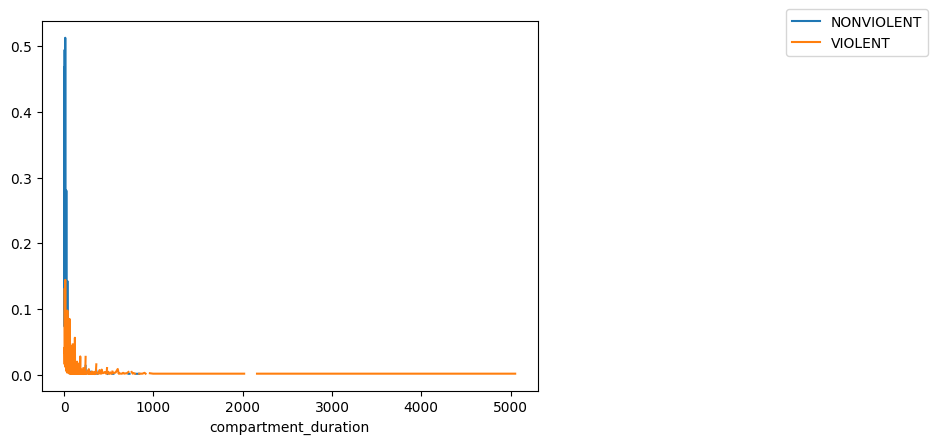

In [307]:
# Only looking at the prison compartment transitions for this check.
transitions_data[transitions_data.compartment == 'prison'].groupby(
    ['compartment_duration', 'crime_type']
).total_population.mean().unstack('crime_type').plot()
plt.legend(bbox_to_anchor=(1.8, 1.05))

Huh, that's also kinda hard to parse. Let's try pulling out just one crime type to look at:

<AxesSubplot: xlabel='compartment_duration'>

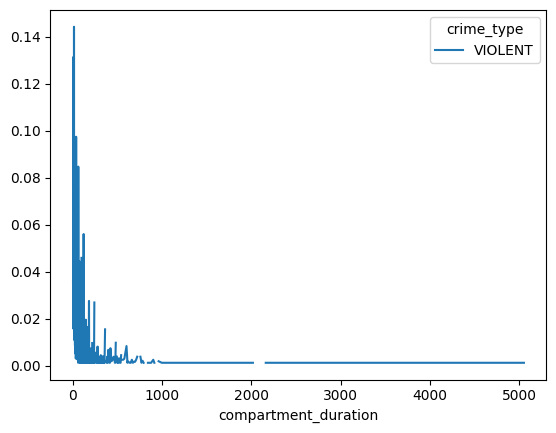

In [308]:
# Feel free to try subbing in a few different crimes to look at them one at a time
CRIME_TYPE = 'VIOLENT'
transitions_data[transitions_data.compartment == 'prison'].groupby(
    ['compartment_duration', 'crime_type']
).total_population.mean().unstack('crime_type')[[CRIME_TYPE]].plot()

## total_population_data
Last but not least: the total_population table. You'll have to go grab data for this one yourself, the data you need is on page 37 of this [report](https://vadoc.virginia.gov/media/1623/vadoc-financial-annual-mis-report-2020.pdf). `total_population_data` is the only table that doesn't need to be disaggreagted by subgroup if the data isn't there for that, so we'll just be creating a table for the total prison population and no disaggregation axis.

As a reminder, total_population_data should have one row of data per time step per full compartment (in our case just `prison`). Here is what a final populations table should look like:

In [309]:
pd.DataFrame({
    'compartment': ['prison'] * 4,
    'time_step': range(3,7),
    'total_population': [2500, 2800, 3030, 2820]
})

,compartment,time_step,total_population
0,prison,3,2500
1,prison,4,2800
2,prison,5,3030
3,prison,6,2820


Okie you're up! Turn the table from the DOC report into a `total_population_data` table! Some important tips for this:
* Make sure your table has exactly the right columns with the right names when you're done. df.rename() is your friend!
* `time_step` is the number of steps away from the reference date you're at. So with a reference date of 2020.0, 2021.0 would be time_step = 12. In our case, the reference_date is 2019.

In [310]:
# Input the data from the DOC report into a pandas DataFrame. Feel free to start with the example table
# above if that's easier. 

total_population_data = pd.DataFrame({
    'compartment': ['prison'] * 12,
    'time_step': range(6, 18),
    'total_population': [29075.0, 28887.0, 28728.0, 28692.0, 28430.0, 28389.0, 28266.0, 28225.0, 28174.0, 27563.0, 26730.0, 26082.0]
})


Let's double check that matches the report we copied from:

<AxesSubplot: xlabel='time_step'>

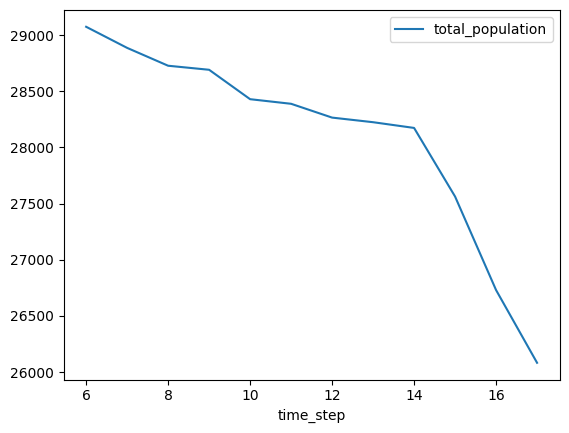

In [311]:
total_population_data.plot(x='time_step', y='total_population')

## Uploading our data
The final step in pre-processing is to upload our data to Google BigQuery. If this next cell gives you a permission error, you need to go set up your Google Cloud access–follow these steps:
1. Work through just the installation section of (this page)[https://cloud.google.com/sdk/docs/quickstart]. Make sure you log in with your Stanford email.
2. Open a terminal window and navigate to your Github repository folder. Run the following commands:
3. `gcloud auth application-default login` --> This will prompt you to log in to your google cloud account
4. `gcloud config set project recidiviz-staging`

Once you're set up, you can try the upload again.


In [346]:
# STEP 1: pick a `simulation_tag` for your simulation. "paco_parole_test" would be a reasonable example...
simulation_tag = "ayesha_parole_test"


upload_spark_model_inputs(
    "recidiviz-staging",
    simulation_tag,
    outflows,
    transitions_data,
    total_population_data,
    '../state/VA/2022/test_configurations/walkthru_user_inputs.yaml',
)

ValueError: Table 'outflows_data' must not contain null values

# Running a baseline
We're ready to build a simulation now! First step is initializing a simulation object, called a SuperSimulation. When we initialize it we pass in the filepath of our YAML configuration, so before you continue you need to go to that file, located in `recidiviz-data/recidiviz/calculator/modeling/population_projection/state/VA/2022/test_configurations`, and change the simulation_tag to match the one you chose above.

In [351]:
# Don't worry about any warnings, as long as this doesn't fail you're in business
spark_sim = SuperSimulationFactory.build_super_simulation(
    '../state/VA/2022/test_configurations/walkthru_user_inputs.yaml'
)

# ask Paco: what are these results? how does working with the YAML configuartion work?

/Users/ayeshakhawaja/.local/share/virtualenvs/recidiviz-data-sdc-xGicju9U/lib/python3.8/site-packages/google/cloud/bigquery/table.py:1979: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


outflows_data returned 612 results


/Users/ayeshakhawaja/.local/share/virtualenvs/recidiviz-data-sdc-xGicju9U/lib/python3.8/site-packages/google/cloud/bigquery/table.py:1979: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


transitions_data returned 1657 results


/Users/ayeshakhawaja/.local/share/virtualenvs/recidiviz-data-sdc-xGicju9U/lib/python3.8/site-packages/google/cloud/bigquery/table.py:1979: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


total_population_data returned 12 results


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/super_simulation/initializer.py:222: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fully_connected_data = fully_connected_data.append(


Now we're going to run a baseline simulation. This is an oppportunity to make sure the data we generated is valid, and to sanity-check the basic dynamics it generates. You should just be able to run the code below, but if you feel like it you can also include `release` in the `display_compartments` list to see that population evolve too.
*Make sure you pause to think about the graph this generates*. Do you believe this is actually close to reality? Is there something off, and if so what might be causing it?

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/m

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

initialization time:  11.922534227371216


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:211: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  (scale_factors[population_disagg_axes] == agg_simulation_attr).all(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:211: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  (scale_factors[population_disagg_axes] == agg_simulation_attr).all

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

simulation_time:  7.1716179847717285


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining 

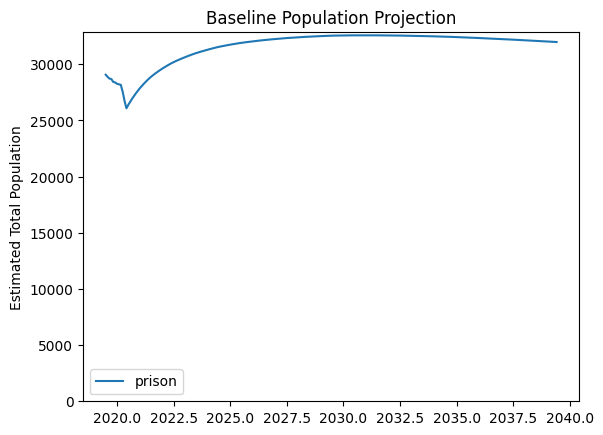

In [352]:
#This can take several minutes to run. You'll see six checkpoints printed out along the way before it finishes.
display_compartments = ['prison']
spark_sim.simulate_baseline(display_compartments)

# ask Paco: what's going on here?

In [328]:
spark_sim.simulator.pop_simulations['baseline_projections'].population_projections


,compartment,time_step,total_population,simulation_group
-115,prison,-115,1345.512947,NONVIOLENT
-114,prison,-114,2543.706485,NONVIOLENT
-113,prison,-113,3664.208595,NONVIOLENT
-112,prison,-112,4644.926671,NONVIOLENT
-111,prison,-111,5578.694427,NONVIOLENT
...,...,...,...,...
121,release,121,38975.583608,VIOLENT
122,release,122,39177.789234,VIOLENT
123,release,123,39379.978131,VIOLENT
124,release,124,39582.185551,VIOLENT


<AxesSubplot: xlabel='time_step'>

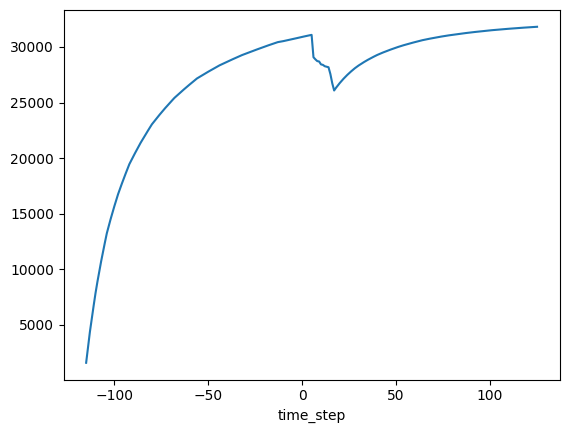

In [343]:
a = spark_sim.simulator.pop_simulations['baseline_projections'].population_projections.groupby(['compartment', 'time_step']).total_population.sum().unstack('compartment')

#.plot(x='time_step', y='total_population')
a.prison.plot()




Before we move on, the other thing we can check is the timesacle analysis (ARIMA) fits that the `pretrial` compartment generated based on our outflows data. Two things to look for:
* Does this trend(s) look believable? Do we think we're capturing a reasonable guess for what could happen going forward?
* Notice any places where a fit is steep up or down and then appruptly flattens. That's a place where the model has enforced that outflows cannot deviate from the present by more than 50%. This is an arbitrary insertion, so it's usually bad news bears if we actually hit that limit.

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:107: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  full_arima_output = self.predictions_df.append(historical_data).sort_index()
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:271: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  arima_output_df = arima_output_df.append(output_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data

[<AxesSubplot: title={'center': 'compartment: pretrial\noutflow_to: prison'}, xlabel='time_step'>]

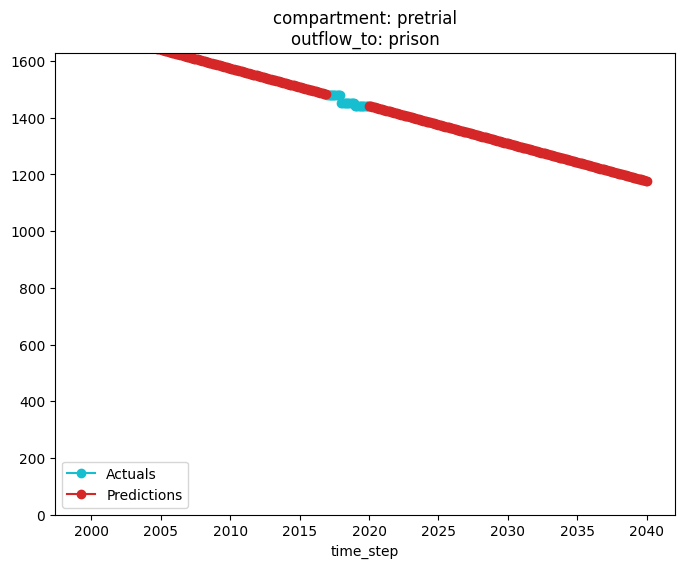

In [353]:
#With `by_simulation_group` set to false, you'll only see one aggregate graph. If you want to see the ARIMA fits
# for each of the subgroups separately, set that to true and run again.
spark_sim.get_arima_output_plots('baseline_projections', by_simulation_group=False)

# Running a policy scenario
I've filled out a lot of the code for you here, but once you finish out the missing pieces definitely play around with the stuff I did for you. The whole appeal of the Spark model is how easy it is to test out different policy scenarios once you get the baseline running.

Without worrying about all the details, the main thing to understand here is that a policy function transforms the transitions data of a given compartment. By applying one or multiple per compartment that is affected in the policy scneario, we can simulate the effects of the reform in question. `policy_list` is thus just a list of policy functions that gets passed into the simulation so it knows what to change in the policy scenario.

Some important pointers:
* A SparkPolicy specifies both compartment and subgroup. If you want a policy to apply to every subgroup you need one SparkPolicy per subgroup!
* Retroactivity determines whether or not a policy applies to people who are already incarcerated. Try toggling it on and off and see what happens!
* Order matters! If policy A shortens sentences by 50% and policy B shortens them by 1 year, the policy_list [A,B] will be different frmo the policy_list [B,A]

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/m

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

initialization time:  33.4020619392395


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/m

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

initialization time:  11.949382066726685


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:211: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  (scale_factors[population_disagg_axes] == agg_simulation_attr).all(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:211: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  (scale_factors[population_disagg_axes] == agg_simulation_attr).all

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

simulation_time:  7.476402997970581


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/population_simulation/population_simulation.py:211: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  (scale_factors[population_disagg_axes] == agg_simulation_attr).all(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalit

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

simulation_time:  7.546525001525879


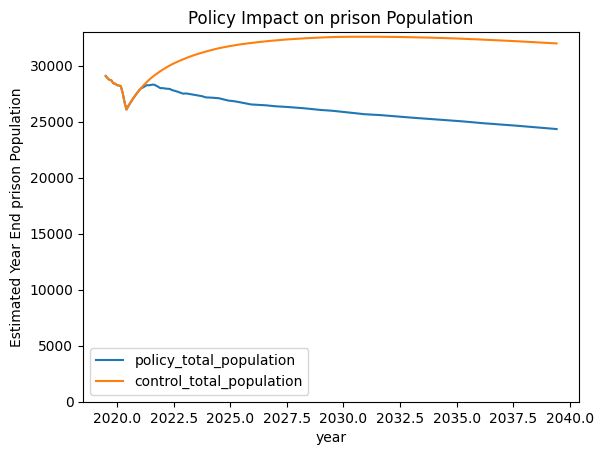

In [356]:
# To start, let's model enabling parole by shortening the fraction of their sentence that people must serve.
# Currently, they cannot serve less than 85%. Let's suppose that this policy will bring that number down to 60%.
# Think about how you should shorten prison transitions to capture that change, then pick the appropriate parameters
# below!
LOS_REDUCTION = 0.29 # This parameter determines how much shorter compartment duration gets for affected individuals.
# or 0.71, if we're assuming that compartment_duration is equa to 85% of a sentence
AFFECTED_FRACTION = 1 # This parameter determines the fraction of the compartment population affected by the change.
REDUCTION_TYPE = '*' # This should either be '*' or '+'. If you make it '+', it will change compartment_duration L to
                    # L - LOS_REDUCTION. If you make it '*', it will change L to L * (1 - LOS_REDUCTION)
RETROACTIVE = False # This should either be True or False

#### Should not have to change things below this line for this cell ####

def apply_reinstated_parole():
    return partial(TransitionTable.apply_reduction, 
                   reduction_df=pd.DataFrame({
                       'outflow': ['release'], # pass in the outflows_to values that this policy applies to
                       'reduction_size': [LOS_REDUCTION], 
                       'affected_fraction': [AFFECTED_FRACTION]
                   }),
                   reduction_type=REDUCTION_TYPE,
                   retroactive=RETROACTIVE)

# Note that I've created for you in this example, and picked it to apply the policy to all subgroups.
policy_list = [SparkPolicy(policy_fn=apply_reinstated_parole(),
                                           spark_compartment='prison',
                                           sub_population={'crime_type': crime},
                                           policy_ts=24,
                                           apply_retroactive=RETROACTIVE) 
                               for crime in transitions_data.crime_type.unique()]
    
test_results = spark_sim.simulate_policy(policy_list, 'prison')

How do those results look? Does this match your expectation for the magnitude of this policy's impact?

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/m

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

initialization time:  18.22631597518921


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/m

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/c

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

initialization time:  11.836409091949463


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/predicted_admissions.py:282: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  predictions_df = predictions_df.append(predictions_df_sub)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

simulation_time:  7.528141021728516


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop_long.append(latest_ts_pop_short.remaining)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.app

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Seri

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:141: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_pop

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:180: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.end_ts_populations = self.end_ts_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/s

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/shell_compartment.py:121: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.outflows[self.current_ts] = pd.Series(outflow_dict, dtype=float)
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/full_compartment.py:106: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  latest_ts_pop = latest_ts_po

/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/sub_simulation/sub_simulation.py:140: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compartment_populations = compartment_populations.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calcula

simulation_time:  7.648446083068848


/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidiviz/calculator/modeling/population_projection/cohort_table.py:68: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.cohort_df = self.cohort_df.append(
/Users/ayeshakhawaja/Downloads/StanfordDecriminalizationCoalition/recidiviz-data-sdc/recidiviz/calculator/modeling/population_projection/sdc_notebooks/../../../../../recidivi

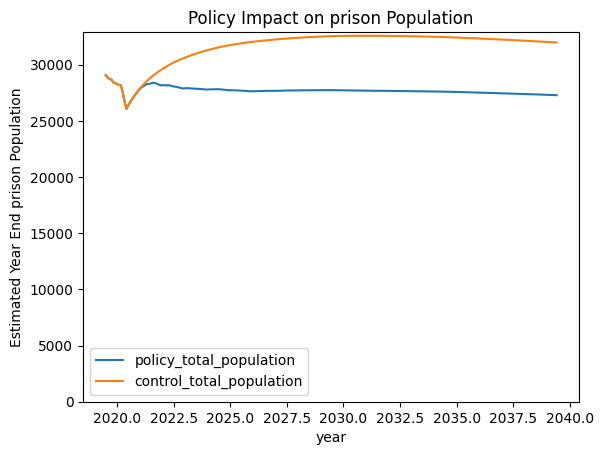

In [357]:
# Now let's try mixing it up a bit. Now I want you to try changing the policy so it only applies to 
# non-violent offenders. What crime_types will that be? How should you change your code to account for this?
# Hint: the only thing inside the parentheses that create the SparkPolicy object that you should need to change is
# the `sub_population`.

LOS_REDUCTION = 0.29
AFFECTED_FRACTION = 1
REDUCTION_TYPE = '*'
RETROACTIVE = False

def apply_reinstated_parole():
    return partial(TransitionTable.apply_reduction, 
                   reduction_df=pd.DataFrame({
                       'outflow': ['release'],
                       'reduction_size': [LOS_REDUCTION], 
                       'affected_fraction': [AFFECTED_FRACTION]
                   }),
                   reduction_type=REDUCTION_TYPE,
                   retroactive=RETROACTIVE)

# policy_list = [SparkPolicy(policy_fn=apply_reinstated_parole(),
#                                            spark_compartment='prison',
#                                            sub_population={'crime_type': crime},
#                                            policy_ts=24,
#                                            apply_retroactive=RETROACTIVE) 
#                                for crime in transitions_data.crime_type.unique()]

policy_list = [SparkPolicy(policy_fn=apply_reinstated_parole(),
                                           spark_compartment='prison',
                                           sub_population={'crime_type': 'NONVIOLENT'},
                                           policy_ts=24,
                                           apply_retroactive=RETROACTIVE)]
    
test_results = spark_sim.simulate_policy(policy_list, 'prison')

How do these results compare to your previous scenario? Is it more or less? By how much? Can you think of a way to validate that that result is reasonable?

# Extensions
WOOOOOO GOOOO YOUUUUUUUU!!!! That's right, you finished the notebook :)
That said, there's tons more to learn, so if you enjoyed that and want to try some more complex variations, here are some extensions:

Try these to get a feel for how each of the things you worked on affects the final result:

### Outflows data
What happens to the simulation when you change the magnitude of outflows data? What about if you added another year (or years) of data?

### Transitions data
What happens to the simulation if you change the `compartment_duration` of the transitions data? What about if you add another row of data (e.g. everything else the same but change the `compartment_duration` for the second one)? What happens if you make release feed to prison instead of itself? Why?

### Total population data
What happens to the simulation if you change the magnitude of the population data? Does it change the beginning and the end of the simulation differently? What happens if you pass an empty table (i.e. `total_population_data = pd.DataFrame()`)?


### We collapsed jail and prison into a single compartment, but they likely behave very differently in real life. Go back to the beginning and re-do the processing after adding a jail compartment to the model architecture. 
A few hints:
1. sentence_type_code == 3 means prison, == 2 equals jail.
2. You'll need to go into the YAML configuration and add a row for jail under every row for prison
3. Bonus: how should we change the policy_list to account for this change?

### Can you implement a different policy (or the same one) using a different policy function from CompartmentTransitions.apply_reduction()?
A few hints:
1. You'll want to go into the 'transitions_table' file in the codebase and scroll to the bottom, where the policy functions are defined, to see what you can try.
2. The mechanics are all the same otherwise, so the only thing you should have to change in is the `apply_reinstated_parole` function.

### Can you add recidivism into the model?
A few hints:
1. The relevant place to make this change is in the transitions_data pre-processing, where we simply assumed everyone in `release` stays there forever. You'll want to add a probability of going back to prison.
2. You'll have to do a little digging on the DOC's website to find statistics for recidivism